In [1]:
import smopy
import folium
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.patches as patches
import pandas as pd
import numpy as np
import random
import seaborn as sns

In [2]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;

<IPython.core.display.Javascript object>

In [3]:
%load_ext folium_magic

- New York, NY 
- Los Angeles, California
- Nashville, TN
- Detroit, MI
- Baltimore, MD
- Seattle, WA

## Pilot sites:

- Redlands, CA
- Richland Co., SC. ~

## Prosecution sites:

- Santa Clara Co., CA ~
- Winnebago, WI ~
- Baton Rouge (East Baton Rouge Parish), LA ~
- Bernadillo Co., NM ~
- Duval Co., FL ~
- Thurston Co., WA ~
- Rockland Co., NY ~

# 1. Define matching populations for increasing sample size

In [4]:
counties = pd.read_csv('co-est2016-alldata_subset.csv')
towns = pd.read_csv('sub-est2016-alldata_subset.csv')
towns.drop_duplicates(['NAME','POPESTIMATE2016'],inplace=True)
towns = towns[towns.NAME!=towns.STNAME]
towns = towns[['County' not in x for x in towns.NAME]]
towns = towns[['(pt.)' not in x for x in towns.NAME]]
towns = towns[['Balance of' not in x for x in towns.NAME]]
towns = towns[['(balance)' not in x for x in towns.NAME]]
towns = towns[towns['POPESTIMATE2016']!=0]

In [5]:
towns.to_csv('reduced_towns.csv')

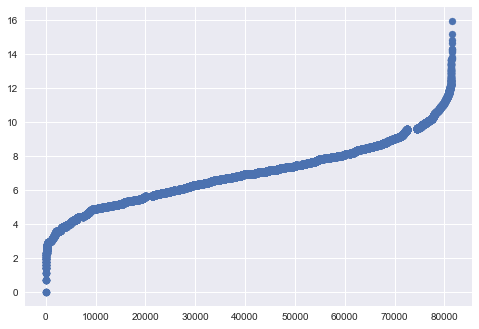

In [6]:
plt.scatter(towns.index,np.log(towns['POPESTIMATE2016'].sort_values()))

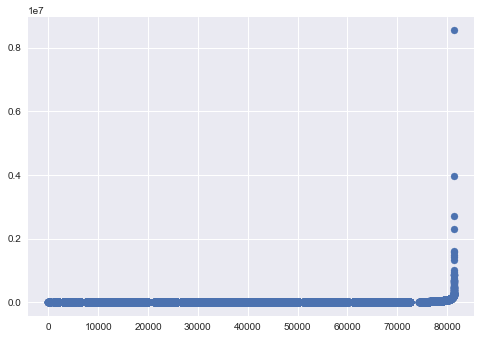

In [7]:
plt.scatter(towns.index,towns['POPESTIMATE2016'].sort_values())

In [8]:

# TRY TO DO FRACTIONS (inversely) PROPORTIONAL TO THE SIZE OF EACH CITY
def select_jurisdictions(data,initial_fraction):
    random.seed(2802)
    included_counties_m = data[data['Manual_inclusion']==1]['POPESTIMATE2016']
    included_counties_names = data[data['Manual_inclusion']==1]['NAME']
    for x,y in zip(included_counties_m, included_counties_names):
        print(str(y))
        #print("Population: "+str(x))
        fraction = initial_fraction
        candidates = data[(data['POPESTIMATE2016'].between((1-fraction)*x, (1+fraction)*x, inclusive=False)) & \
                          (~data['NAME'].isin(included_counties_names))].index
        
        while (len(candidates) < 2):
            fraction += 0.1
            candidates = data[(data['POPESTIMATE2016'].between((1-fraction)*x, (1+fraction)*x, inclusive=False)) & \
                              (~data['NAME'].isin(included_counties_names))].index   
        #print("Search radius: "+str(fraction))
        ct = random.choice(candidates)
        data.loc[ct,'Needed_inclusion'] = 1
        #print(data.loc[candidates,:])
        #print("Matching town: ")
        print(data.loc[ct][['STNAME','NAME','POPESTIMATE2016']].values)
        print("")
        
        

In [9]:
select_jurisdictions(towns,.1)

Los Angeles city
['Illinois' 'Chicago city' 2704958]

Redlands city
['Minnesota' 'Eagan city' 66428]

Baltimore city
['Massachusetts' 'Boston city' 673184]

Detroit city
['Texas' 'El Paso city' 683080]

New York city
['Texas' 'Houston city' 2303482]

Nashville-Davidson metropolitan government
['Nevada' 'Las Vegas city' 632912]

Seattle city
['District of Columbia' 'Washington city' 681170]



In [10]:
select_jurisdictions(counties,.05)

Santa Clara County
['Texas' 'Bexar County' 1928680]

Duval County
['New York' 'Erie County' 921046]

Bernalillo County
['Illinois' 'Lake County' 703047]

East Baton Rouge Parish
['Ohio' 'Lucas County' 432488]

Richland County
['Arkansas' 'Pulaski County' 393250]

Rockland County
['Colorado' 'Douglas County' 328632]

Thurston County
['California' 'San Luis Obispo County' 282887]

Winnebago County
['Kentucky' 'Kenton County' 164945]



(Changed Lake County to Jackson county -came up with it using a different seed- because it falls within the Chicago metropolitan area which is already in our list)

# 2. Define geographies and produce, visualize and save corresponding maps

In [11]:
# Coordinates (upper left and lower right) 
juris_dict = {
    
    'New York': [-74.257118, 40.911309, -73.700254, 40.485452], 
    'Houston': [-95.813315, 30.133315, -95.037406, 29.526930],
    
    'Los Angeles': [-118.694684, 34.350370, -117.858083, 33.558664],
    'Chicago, IL': [-87.971568, 42.047215, -87.490656, 41.630378],
    
    'Nashville': [-87.045726, 36.388082, -86.518172, 35.963951],
    'Las Vegas, NV': [-115.447428, 36.384162, -115.006297, 36.015230],
    
    'Detroit': [-83.400165, 42.570363, -82.873412, 42.222532],
    'El Paso, TX': [-106.653179, 32.004576, -106.192440, 31.611867],
    
    'Baltimore': [-76.770649, 39.414438, -76.487698, 39.190476],
    'Boston, MA': [-71.198945, 42.405593, -70.966859, 42.260420],
    
    'Seattle': [-122.445623, 47.737144, -122.226861, 47.491494],
    'Washington, D.C.': [-77.115390, 38.994653, -76.894947, 38.830883],
    
    'Redlands, CA': [-117.257080, 33.966542, -117.036929,34.108485],
    'Eagan city, MN': [-93.236549, 44.863883, -93.101403, 44.774482],
    
    'Richland, SC': [-81.389102, 34.260967, -80.568427, 33.751430],
    'Genesee, MI': [-83.699419, 43.138292, -83.573077, 43.045778],
    
    'Santa Clara, CA': [-122.027937, 37.424878, -121.922101, 37.313640],
    'Bexar, TX': [-98.832552, 29.752529, -98.101961, 29.123447],
    
    'Winnebago, WI': [-88.901814, 44.255881, -88.397991, 43.880343],
    'Kenton, KY': [-84.633840, 39.097515, -84.392141, 38.802213],
    
    'Baton Rouge, LA': [-91.320497, 30.734743, -90.829456, 30.291573],
    'Lucas, OH': [-83.893994, 41.739738, -83.178509, 41.406872],
    
    'Duval, FL': [-82.076054, 30.621692, -81.324093, 30.090064],
    'Erie, NY': [-79.156287, 43.091765, -78.424323, 42.470890],
    
    'Thurston, WA': [-123.234222, 47.189895, -122.148060, 46.762798],
    'San Luis Obispo, CA': [-120.726177, 35.313684, -120.616828, 35.237026],
    
    'Rockland, NY': [-74.269744, 41.326738, -73.892241, 40.995225],
    'Douglas, CO': [-105.309384, 39.573343, -104.647458, 39.109217],
    
    'Bernalillo, NM': [-106.585276, 35.337001, -106.517601, 35.287490],
    'Jackson, MO': [-94.643005, 39.238704, -94.110168, 38.824799]
}

In [12]:
def produce_map(site_name, coord_list):
    map = smopy.Map((coord_list[3], coord_list[0], coord_list[1], coord_list[2]))
    x, y = map.to_pixels(pd.Series([coord_list[1], coord_list[3]]), pd.Series([coord_list[0], coord_list[2]]))
    ax = map.show_mpl(figsize=(40,40));
    rect = patches.Rectangle((x[0], y[0]), x[1]-x[0], y[1]-y[0], linewidth=10, edgecolor='black', facecolor='none')
    ax.add_patch(rect)
    plt.savefig('./images/'+site_name+'.png')

Lowered zoom level to keep map size reasonable. (z = 11)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 13)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 12)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 11)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 11)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 12)
Lowered zoom level to keep map size reasonable. (z = 12)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 11)
Lowered zoom level to keep map 

/Users/sarangof/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Lowered zoom level to keep map size reasonable. (z = 12)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 13)
Lowered zoom level to keep map size reasonable. (z = 10)
Lowered zoom level to keep map size reasonable. (z = 9)
Lowered zoom level to keep map size reasonable. (z = 11)
Lowered zoom level to keep map size reasonable. (z = 12)
Lowered zoom level to keep map size reasonable. (z = 10)


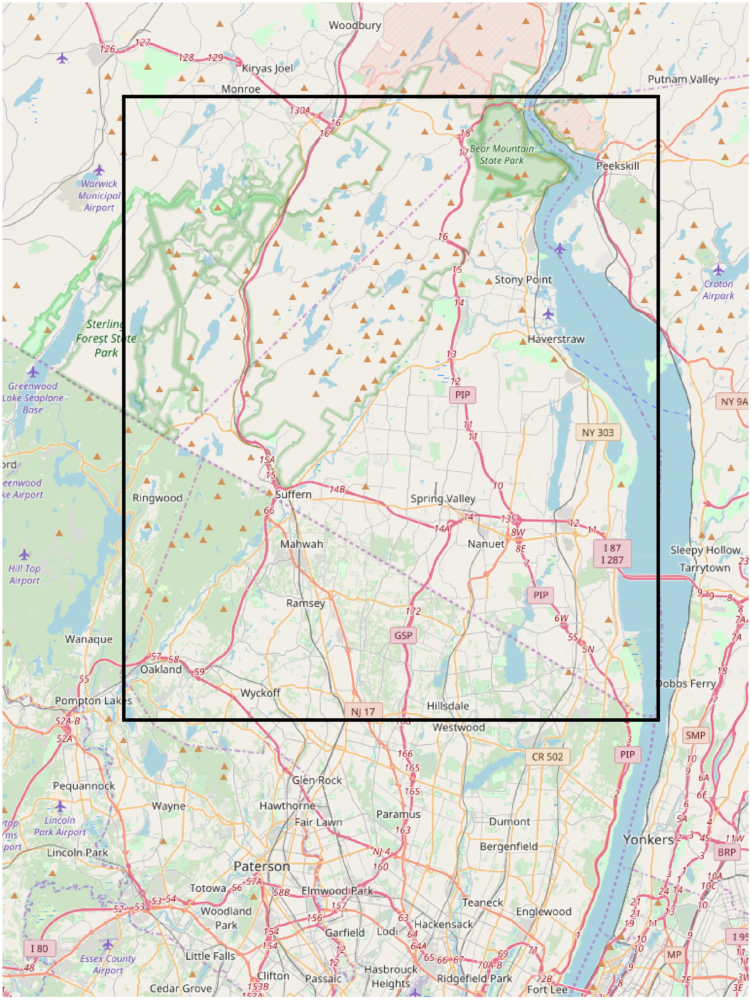

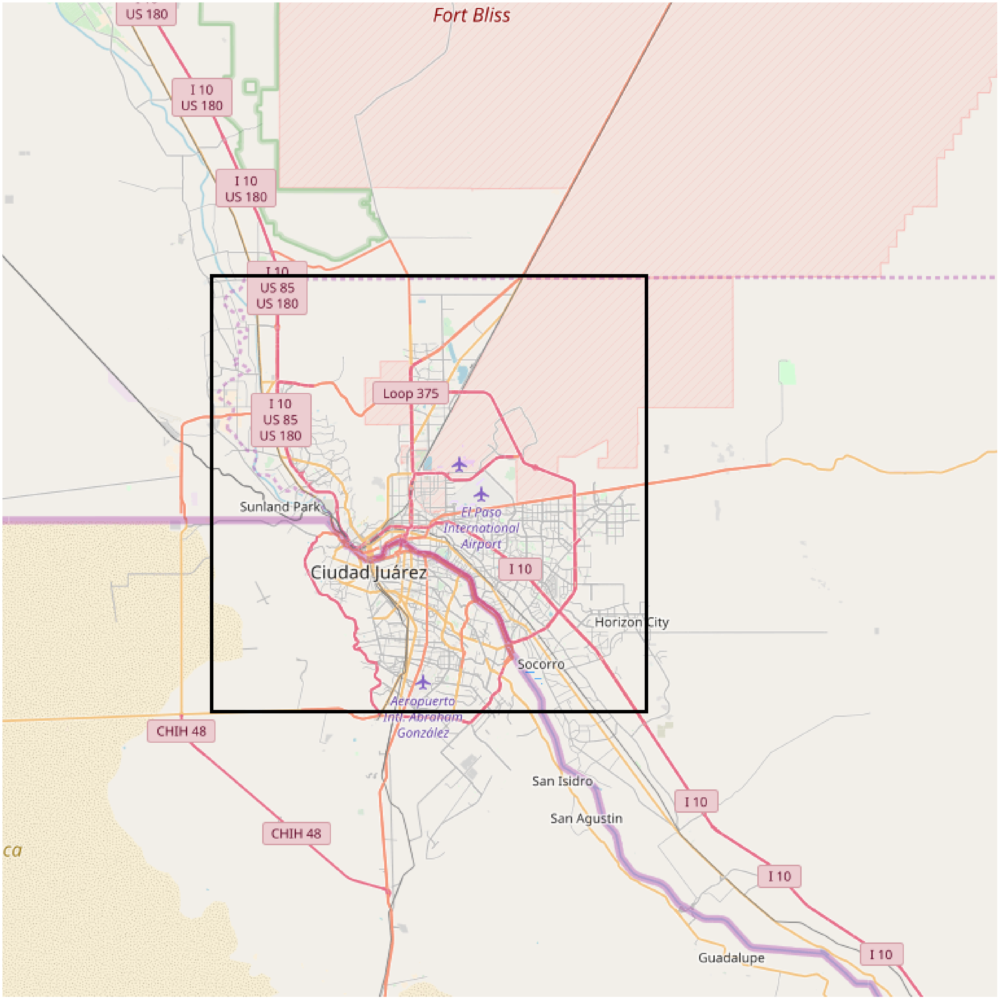

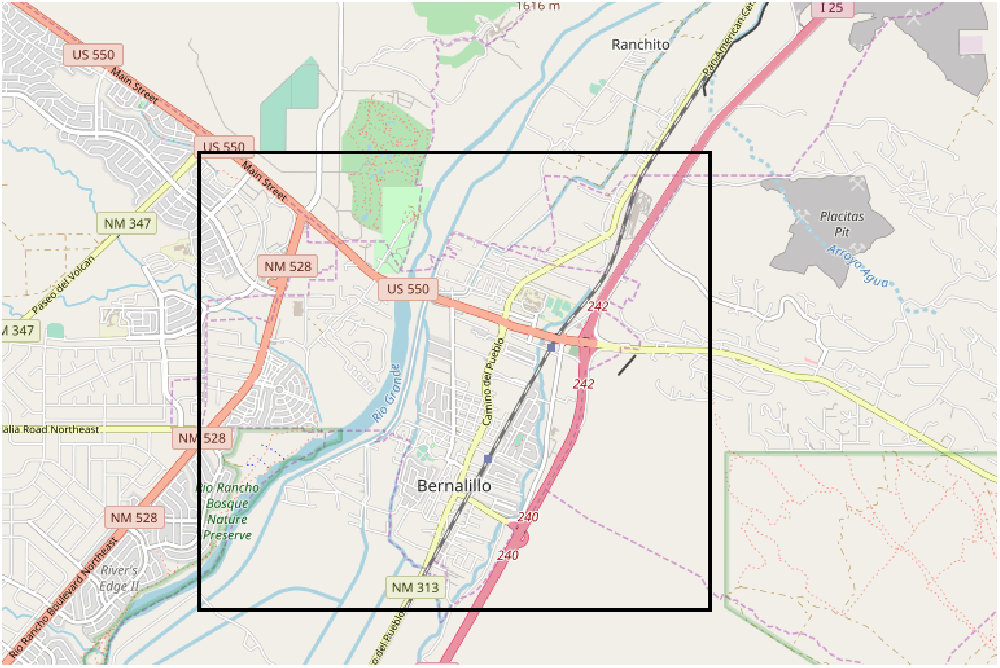

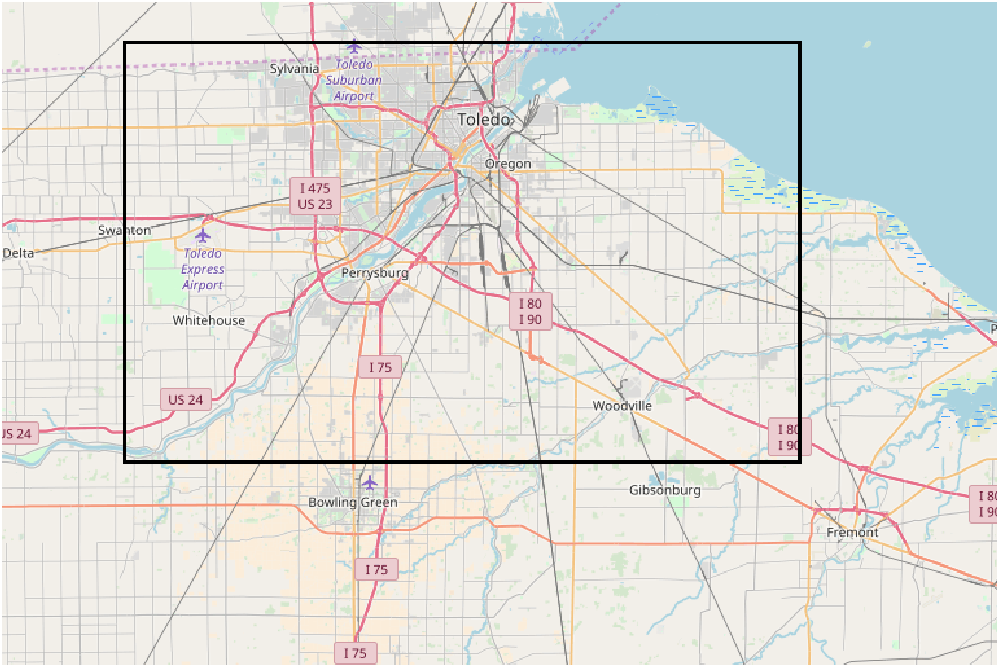

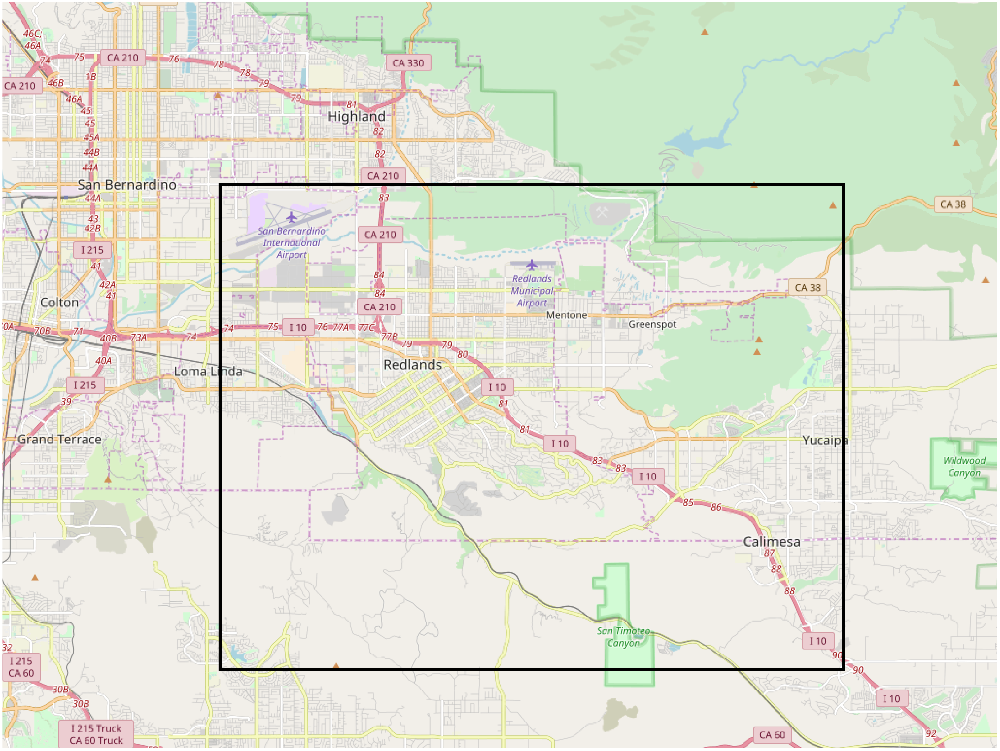

...

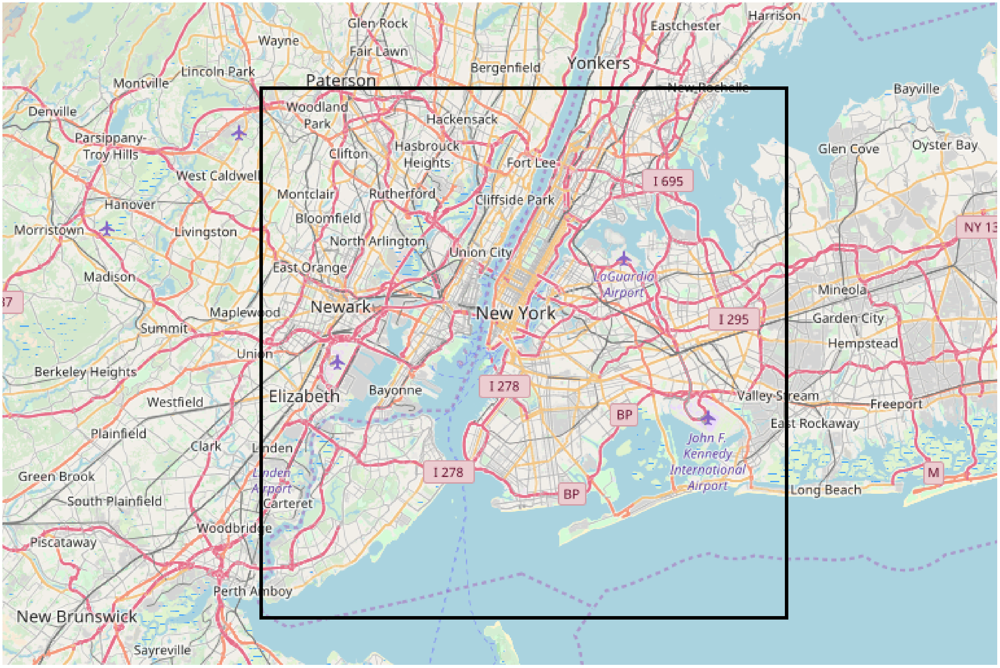

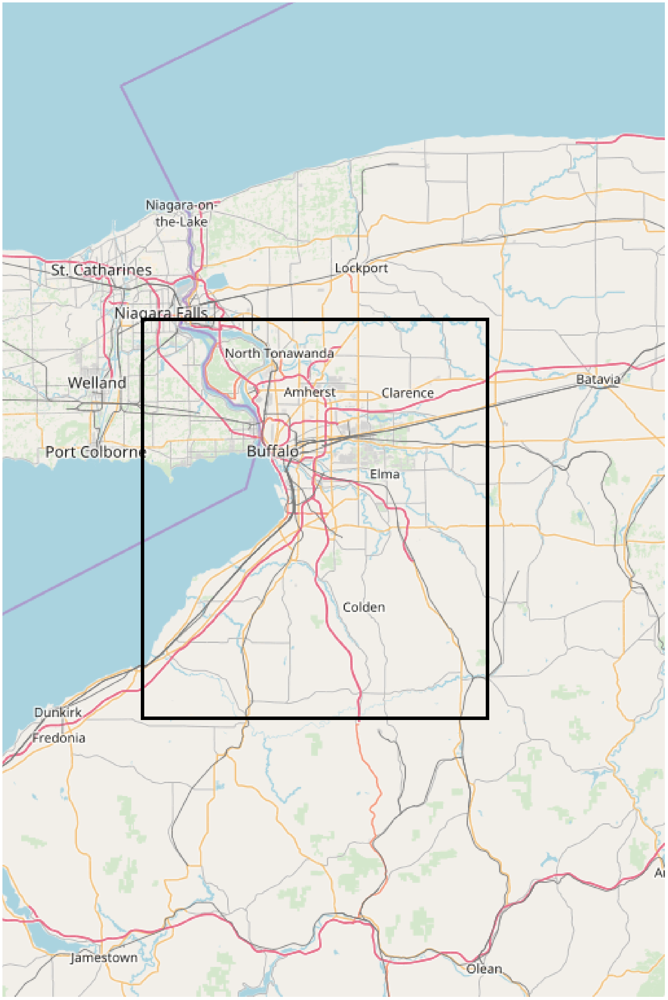

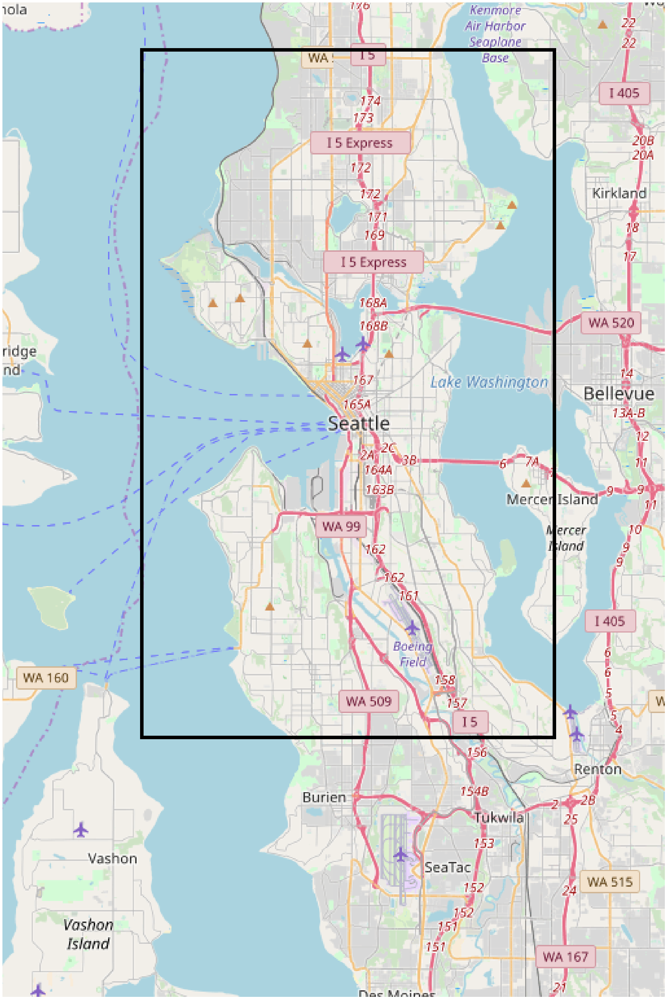

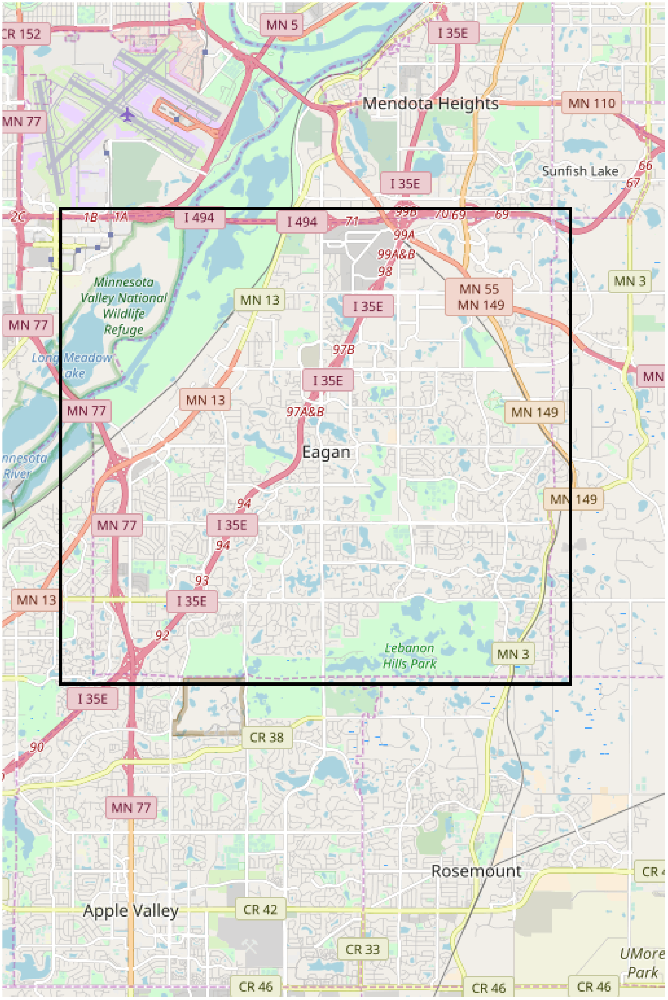

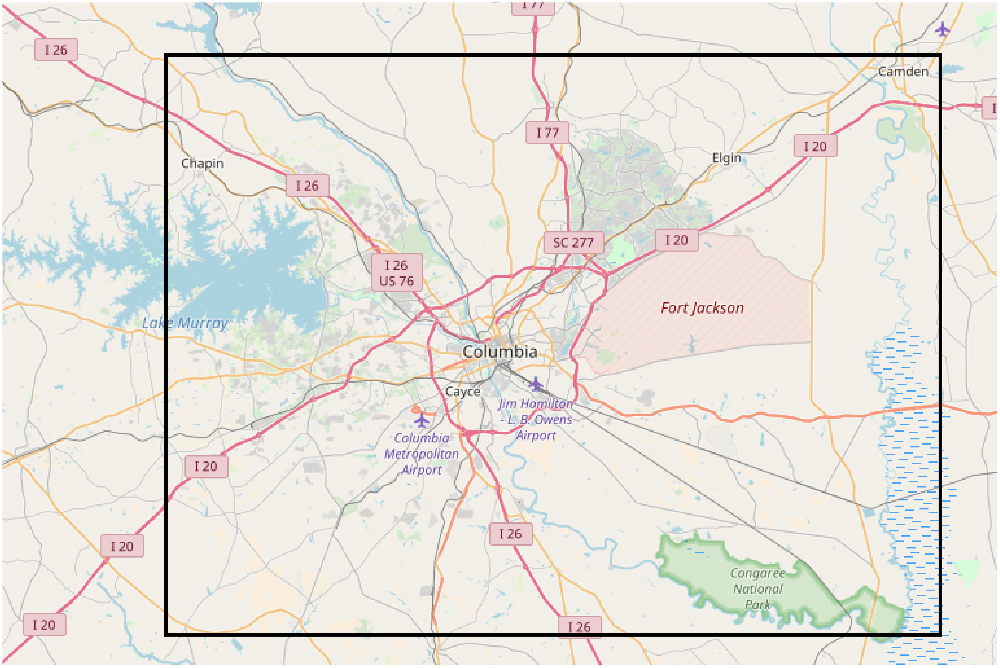

In [13]:
for site, coords in juris_dict.iteritems():
    produce_map(site, coords)

In [14]:
"""
map_object = folium.Map(location = [65, -18.6], zoom_start=6, tiles="Stamen toner")
marker = folium.features.Marker([64.127573, -21.903975], popup="Icelandic Meteorology Office")
map_object.add_children(marker)
folium.Map.save(map_object, "index.html")
""";